# Transportation and Mobility Changes in the United Kingdom During the COVID-19 Pandemic
### Julie Dawkins, Ruyan Yu, Cassandra Zhang

## Notebook instructions and Prerequisites

#### Import Modules
*Please install any necessary modules using anaconda install or pip install before running.*

In [53]:
# import modules here
# uncomment below if you would like to directly use bigquery
# from google.cloud import bigquery
import pandas as pd
import numpy as np
import requests
from bs4 import BeautifulSoup
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import requests
import pickle 
import geopy.geocoders
from matplotlib.ticker import FuncFormatter
from scipy.spatial.distance import pdist, squareform
import plotly.graph_objects as go
import altair as alt
import scipy.stats as stats
from IPython.display import display
import statsmodels.api as sm
import plotly.graph_objects as go
import warnings
warnings.simplefilter("ignore")


### Table of Contents<br><br>
* [1. Introduction](#1)
    * [1.1 Background](#1_1)
    * [1.2 Research Questions and Objectives](#1_2)
    * [1.3 Dataset Explanation and Source](#1_3)
* [2. Data Extracting and Wrangling](#2)
    * [2.0 A Note on Big Query](#2_0)
    * [2.1 Import raw data](#2_1)
    * [2.2 Cleaning UK's economic and transport change data](#2_2)
    * [2.3 Cleaning UK's rail mobility data](#2_3)
    * [2.4 Join dataframes](#2_4)
    * [Exploratory data analysis](#2_5)
* [3. Data Visualisation and Analysis](#3)
    * [Question 1: How did COVID-19 impact public transport usage by station, location, and region?](#3_1)
    * [Question 2: Which stations were more heavily impacted, and how did they recover?](#3_2)
        * [Question 2.1 : Are there clusters of stations which recovered similarly?](#3_2_1)
    * [Question 3: What regions saw the largest impact in other forms of mobility in terms of retail and recreation, grocery and pharmacy, and workplaces?](#3_3)
    * [Question 4: Is there a correlation between public transit usage and mobility of retail, grocery store usage, and workplace use (our proxies for economic indicators)?](#3_4)

* [4. Results and Conclusion](#4)
* [References](#5)


## 1. Introduction <a id="1"></a>

<a id="1_1"></a>
### 1.1 Background 
The COVID-19 pandemic massively shifted human mobility behaviours. Precautions and policies formulated by governments worldwide -- such as lock-downs and stay-at-home orders -- helped to limit the spread of the virus, but also sharply reduced the movement of individuals both within their regions and across nations. We are interested in quantifying this decrease in movement by examining train entrances and exits in the United Kingdom. 

Further, research shows that differences in how people of varying socio-economic statuses adapted to changes in travel behavior during COVID-19 widened the economic gap and heightened equity concerns. In particular, higher-income individuals have greater access to travel substitutions (i.e., from public transportations to private transportation) (Brough et al., 2021), more chances to work remotely and a lower unemployment rate (Mack et al., 2021). These factors combined to create a greater gap between high and low socio-ecomonic status groups. 

However, previous literature focused more on the general indexes measuring ecomomic status (e.g., incomes, employment rates). In contrast, this research leverages unique Google mobility data to examine how the pandemic impacted both larger travel patterns (i.e., via train) *and* mobility within towns/cities -- including changes in mobility to retail/recreation, grocery and pharmacy movement, etc. Using the mobility to local institutions as a proxy for economic health, we seek to examine how changes in larger transportation patterns impacted local mobility toward grocery stores and retail. 

Our hypothesis is that because foot traffic increases the velocity of money (as individuals spend money where they travel through), locations with larger drops in public transit usage also saw greater drops in mobility in key economic generators such as grocery stores and retail locations, implying a greater economic loss. If this hypothesis is true, it may provide greater evidence of the economic inequity exacerbated at multiple levels by the COVID-19 pandemic.

We focus data analysis within the UK since different countries had varying pandemic policies, and people under diverse cultural backgrounds could show different behaviours towards the policies combating COVID-19 (Zhang et al., 2021). The UK is an interesting case study because it has a rich public transit network of trains spreading throughout the country. Therefore, we can extrapolate decreases in public transit movement to greater decreases of the public at large (something that may be harder to measure in a more car-reliant country). 


### 1.2 Research Questions and Objectives <a class="anchor" id="1_2"></a>

This notebook investigates 4 following research questions:
1. How did COVID-19 impact public transporation usage in the UK? 
2. What stations saw the largest decrease in usage, and how did they recover over time?
    - 2.1. Are there clusters of train stations that recovered similarly?
3. What regions saw the largest impact in other forms of mobility in terms of retail and recreation, grocery and pharmacy, and workplaces? 
4. Is there a correlation between public transit usage and mobility of retail, grocery store usage, and workplace use (our proxies for economic indicators)?

### 1.3 Dataset Explanation and Source <a class="anchor" id="1_3"></a>

The research adopted 2 primary datasets:

1. <b>The Google Community Mobility Reports</b>: This unique Google dataset includes approximately 400,000 observations and provides insights about the economic and social changes influenced by policies aiming to combat COVID-19. Each observation in the dataset reports, for a given region and time, the movement trends across locations categorized by retail and recreation, groceries and pharmacies, parks, transit stations, workplaces, and residential areas. Data can be found on locations worldwide -- but more importantly for our purposes, it was mapped across diverse geographical locations in the UK from 2020 to 2022 (see Table 1.3.1). The dataset can be accessed on the [Google Cloud Platform here.](https://console.cloud.google.com/marketplace/product/bigquery-public-datasets/covid19_google_mobility?pli=1)

<b><i>Table 1.3.1:</i></b> Descriptions of 'Google Community Mobility Reports' dataset
<table>
<tr><th>Column Heading <th> Data Type <th> Explanation
<tr><tr><tr><td> country_region_code <td> STRING <td> 2 letter alpha code for the country/region in which changes are measured relative to the baseline. These values correspond with the ISO 3166-1 alpha-2 codes
<tr><tr><tr><td> country_region <td> STRING <td> The country/region in which changes are measured relative to the baseline
<tr><tr><tr><td> sub_region_1 <td> STRING <td> First geographic sub-region in which the data is aggregated. This varies by country/region to ensure privacy and public health value in consultation with local public health authorities
<tr><tr><tr><td> sub_region_2 <td> STRING <td> Second geographic sub-region in which the data is aggregated. This varies by country/region to ensure privacy and public health value in consultation with local public health authorities
<tr><tr><tr><td> metro_area <td> STRING <td> A specific metro area to measure mobility within a given city/metro area. This varies by country/region to ensure privacy and public health value in consultation with local public health authorities
<tr><tr><tr><td> iso_3166_2_code <td> STRING <td> Unique identifier for the geographic region as defined by ISO Standard 3166-2.
<tr><tr><tr><td> census_fips_code <td> STRING <td> Unique identifier for each US county as defined by the US Census Bureau. Maps to county_fips_code in other tables
<tr><tr><tr><td> place_id <td> STRING <td> A textual identifier that uniquely identifies a place in the Google Places database and on Google Maps
<tr><tr><tr><td> date <td> DATE <td> Changes for a given date as compared to baseline. Baseline is the median value for the corresponding day of the week during the 5-week period Jan 3–Feb 6 2020
<tr><tr><tr><td> retail_and_recreation_percent_change_from_baseline <td> INTEGER <td> Mobility trends for places like restaurants, cafes, shopping centers,theme parks, museums, libraries, and movie theaters
<tr><tr><tr><td> grocery_and_pharmacy_percent_change_from_baseline <td> INTEGER <td> Mobility trends for places like grocery markets, food warehouses, farmers markets, specialty food shops, drug stores, and pharmacies
<tr><tr><tr><td> parks_percent_change_from_baseline <td> INTEGER <td> Mobility trends for places like local parks, national parks, public beaches, marinas, dog parks, plazas, and public gardens
<tr><tr><tr><td> transit_stations_percent_change_from_baseline <td> INTEGER <td> Mobility trends for places like public transport hubs such as subways, buses, and train stations
<tr><tr><tr><td> workplaces_percent_change_from_baseline <td> INTEGER <td> Mobility trends for places of work
<tr><tr><tr><td> residential_percent_change_from_baseline <td> INTEGER <td> Mobility trends for places of residence
<tr><tr><tr><td> source_url <td> STRING <td> Source
<tr><tr><tr><td> etl_timestamp <td> TIMESTAMP <td> Load time for this data row  <tr>

<table>


2. <b>Time series of passenger entries and exits and interchanges by station</b>: This dataset includes 2500+ stations in the UK. It contains the total number of passenger entries and exits by train station from 1997 to 2024 (see Table 1.3.2). It is offically released by the Office of Rail and Road UK. The dataset can be found and downloaded for [free from the website](https://dataportal.orr.gov.uk/statistics/usage/estimates-of-station-usage) (find the file named as: Table 1415 - Time series of passenger entries and exits and interchanges by station (ods)).

<b><i>Table 1.3.2:</i></b> Descriptions of 'Time series of passenger entries and exits by station' dataset
<table>
<tr><th>Column Heading <th> Data Type <th> Explanation
<tr><tr><tr><td> Sort <td> INTEGER <td> Index of each dataset, can be used to reset the data into original order
<tr><tr><tr><td> Station name <td> STRING <td> Name of station: National Rail Enquiries (NRE)
<tr><tr><tr><td> Three Letter Code (TLC) <td> STRING <td> Three letter abbreviation code: NRE
<tr><tr><tr><td> National Location Code (NLC) <td> INTEGER <td> National Location Code: NRE
<tr><tr><tr><td> Region <td> STRING <td> Region where the station is located: Office for National Statistics (ONS) Open Geography portal
<tr><tr><tr><td> Local authority: district or unitary <td> STRING <td> Local authority split by districts and unitaries: ONS Open Geography portal
<tr><tr><tr><td> Apr Year1 to Mar Year2 <td> INTEGER <td> Estimated total number of entries and exits made at the station during April Year1 to March Year2 <tr>

<table>

<i>Additional Data Sources</i>: 

We scraped the ISO codes for every subdivision in the UK from [this Wikipedia webpage](https://en.wikipedia.org/wiki/ISO_3166-2:GB). These codes define the locations within the UK and provide the unique identifier for all the principal subdivisions (e.g., provinces or states) in the UK. This data is used to merge our two primary data sets. 

Further, for geographic visualizations, we attained the following additional datasets:

- the regional boundaries of the UK from the Office for National Statistics, which can be found [here.](https://geoportal.statistics.gov.uk/maps/ons::international-territorial-level-itl-geography-hierarchy-boundaries-january-2021-uk-online/explore?location=53.984817%2C-1.874400%2C4.32&path=) Source: Office for National Statistics licensed under the Open Government Licence v.3.0
- the latitude and longitudinal location of every station in the UK, found at [this GitHub repo](https://github.com/ellcom/UK-Train-Station-Locations) by user ellcom.

## 2. Data Extracting and Wrangling <a id="1"></a>

### 2.0: A note on BigQuery <a class="anchor" id="2_0"></a>

In order to acquire the Google Mobility data, we downloaded data from the Google Cloud service, BigQuery. COVID mobility data is publicly available for free. If you are interested in downloading the data directly from BigQuery, set up a Google Cloud account following [these instructions](https://cloud.google.com/docs/authentication/set-up-adc-local-dev-environment), import google.cloud from bigquery, and run the below query, substituting "PROJECT_NAME" with your project name. 

Alternatively, the data is available as a .csv in the /data folder. This is where the data is imported from for all cleaning purposes.

The code to initialize BigQuery looks as follows: 

client = bigquery.Client("PROJECT_NAME")

query = 
SELECT *
FROM `bigquery-public-data.covid19_google_mobility.mobility_report`
WHERE country_region = "United Kingdom"

query_job = client.query(query)  
results = query_job.result()  
df = results.to_dataframe()  

### 2.1 Import raw data <a class="anchor" id="2_1"></a>

In [54]:
# Import UK's economic and transport change data
uk_mobility_df = pd.read_csv("data/uk_mobility_data.csv")

# Import UK's rail station mobility data
station_mobility_df = pd.read_csv("data/time-series-of-passenger-entries-and-exits-and-interchanges-by-station.csv", skiprows=3,encoding='ISO-8859-1')

# Scrape ISO codes for UK's second-level subdivision locations
web = requests.get("https://en.wikipedia.org/wiki/ISO_3166-2:GB")
soup = BeautifulSoup(web.content, "html.parser")

subdivition_section_header = soup.find("h3", {"id": "Second-level_subdivisions"})
table = subdivition_section_header.find_next("table", {"class": "wikitable"})
rows = table.find_all("tr")[1:]

iso_codes = []
for row in rows:
    cell = row.find_all("td")
    if len(cell) > 1:
        code = cell[0].text.strip()
        name = cell[1].text.strip()
        iso_codes.append((code, name))

# Format the ISO codes and location names into a dataframe
iso_codes_df = pd.DataFrame(iso_codes, columns=["ISO_code", "Location_name"])

# Clean up the location names in the ISO codes dataframe
iso_codes_df['Location_name'] = iso_codes_df['Location_name'].replace(
    {
        r'Bridgend \[Pen-y-bont ar Ogwr GB-POG\]': 'Bridgend - Pen-y-bont ar Ogwr',
        r'Caerphilly \[Caerffili GB-CAF\]': 'Caerphilly - Caerffili',
        r'Cardiff \[Caerdydd GB-CRD\]': 'Cardiff - Caerdydd',
        r'Carmarthenshire \[Sir Gaerfyrddin GB-GFY\]': 'Carmarthenshire - Sir Gaerfyrddin',
        r'Ceredigion \[Sir Ceredigion\]': 'Ceredigion - Sir Ceredigion',
        r'Denbighshire \[Sir Ddinbych GB-DDB\]': 'Denbighshire - Sir Ddinbych',
        r'Flintshire \[Sir y Fflint GB-FFL\]': 'Flintshire - Sir y Fflint',
        r'Isle of Anglesey \[Sir Ynys Môn GB-YNM\]': 'Isle of Anglesey - Sir Ynys Môn',
        r'Merthyr Tydfil \[Merthyr Tudful GB-MTU\]': 'Merthyr Tydfil - Merthyr Tudful',
        r'Monmouthshire \[Sir Fynwy GB-FYN\]': 'Monmouthshire - Sir Fynwy',
        r'Neath Port Talbot \[Castell-nedd Port Talbot GB-CTL\]': 'Neath Port Talbot - Castell-nedd Port Talbot',
        r'Newport \[Casnewydd GB-CNW\]': 'Newport - Casnewydd',
        r'Pembrokeshire \[Sir Benfro GB-BNF\]': 'Pembrokeshire - Sir Benfro',
        r'Rhondda Cynon Taff\s*\[Rhondda CynonTaf\]': 'Rhondda Cynon Taf - Rhondda Cynon Taf',
        r'Swansea \[Abertawe GB-ATA\]': 'Swansea - Abertawe',
        r'Torfaen\s*\[Tor-faen\]': 'Torfaen - Tor-faen',
        r'Vale of Glamorgan, The\s*\[Bro Morgannwg GB-BMG\]': 'Vale of Glamorgan - Bro Morgannwg',
        r'Wrexham \[Wrecsam GB-WRC\]': 'Wrexham - Wrecsam'
    },   
    regex=True 
)

### 2.2 Cleaning Google COVID-19 Mobility data for the UK <a class="anchor" id="2_2"></a>

For this data, we generate we will generate 1 yearly averaged COVID-19 Mobility dataset to prepare the data for our final dataset. 

In [55]:
# Rename the iso columns and locations to match the other dataframes
uk_mobility_df = uk_mobility_df.rename(columns={
    'iso_3166_2_code': 'ISO_code',
    'sub_region_1': 'Location_name'
})

# Drop unnecessary columns
uk_mobility_df = uk_mobility_df.drop(columns=['country_region_code', 'country_region', 'place_id','census_fips_code', 'source_url','etl_timestamp']).dropna(subset=['ISO_code'])
# Set the 'date' column in datetime format and create a 'year' column
uk_mobility_df['date'] = pd.to_datetime(uk_mobility_df['date'])
uk_mobility_df['year'] = uk_mobility_df['date'].dt.year

# Group the data by year
grouped = uk_mobility_df.groupby('year')

# Initialize an empty dictionary to store grouped DataFrames
yearly_data = {}

# Iterate through groups and store DataFrames by year
for year, group in grouped:
    if year in [2020, 2021, 2022]:
        yearly_data[year] = group

# Define a reusable function for averaging
def compute_yearly_averages(df):
    return df.groupby(['Location_name', 'year', 'ISO_code']).agg({
        'retail_and_recreation_percent_change_from_baseline': 'mean',
        'grocery_and_pharmacy_percent_change_from_baseline': 'mean',
        'parks_percent_change_from_baseline': 'mean',
        'transit_stations_percent_change_from_baseline': 'mean',
        'workplaces_percent_change_from_baseline': 'mean',
        'residential_percent_change_from_baseline': 'mean'
    }).reset_index()

# Compute averages for each year and store them
yearly_averages_COVID_19_mobility = {year: compute_yearly_averages(df) for year, df in yearly_data.items()}



###  2.3 Cleaning UK's rail station data <a class="anchor" id="2_3"></a>

From this data, we will generate one all station dataset (2019-2024) and prep the data for our final dataset. 

The following code generates all station data from April 2019 - March 2024.

In [56]:
# Clean and format the column names in the station mobility dataframe
station_mobility_df.columns = station_mobility_df.columns.str.replace('\n', ' ', regex=False)
station_mobility_df.columns = station_mobility_df.columns.str.replace('[b]', '', regex=False)
station_mobility_df.columns = station_mobility_df.columns.str.strip()
station_mobility_df.rename(columns={'Local authority: district or unitary': 'Location_name'}, inplace=True)

# Convert passenger numbers to numeric values
station_mobility_df.iloc[:, 6:] = station_mobility_df.iloc[:, 6:].apply(lambda x: x.str.replace(',', ''), axis=1)
station_mobility_df.iloc[:, 6:] = station_mobility_df.iloc[:, 6:].apply(pd.to_numeric, errors='coerce')

cols_to_drop = station_mobility_df.columns[(station_mobility_df.columns >= 'Apr 1997 to Mar 1998') & (station_mobility_df.columns <= 'Apr 2018 to Mar 2019')]
station_mobility_df = station_mobility_df.drop(columns=cols_to_drop)
station_mobility_df_19_to_24 = station_mobility_df.drop(columns=['Sort'])

station_mobility_long = station_mobility_df_19_to_24.melt(
    id_vars=['Location_name', 'Station name', 'Region', 'Three Letter Code (TLC)', 'National Location Code (NLC)'],  
    value_vars=['Apr 2019 to Mar 2020', 'Apr 2020 to Mar 2021', 'Apr 2021 to Mar 2022', 'Apr 2022 to Mar 2023', 'Apr 2023 to Mar 2024'],            
    var_name='Date',                 
    value_name='Total_number_of_passenger_entries_and_exits'                      
)

# remove stations with no data
station_mobility_long['Total_number_of_passenger_entries_and_exits'] = station_mobility_long['Total_number_of_passenger_entries_and_exits'].replace('[z]', np.nan)

station_mobility_long.dropna(subset=['Total_number_of_passenger_entries_and_exits'], inplace=True)

station_mobility_long['Year'] = station_mobility_long['Date'].str.extract(r'(\d{4})')
station_usage = station_mobility_long.drop(columns=['Date'])
station_usage = station_usage[station_usage['Region'] != '[z]']

# if you want to export the data, uncomment the next line
# station_usage.to_csv("exclusively_station_mobility_long.csv")


### 2.4 Join dataframes <a class="anchor" id="2_4"></a>

The following data joins the dataframes, combining the averaged yearly data from the Google COVID-19 Mobility data with yearly train exits/entries, summed by location. The two data sets are merged by ISO code. 

In [57]:
# First: add ISO codes to station mobility data and generate the total travel by location

station_mobility_df_merged = station_mobility_long.merge(iso_codes_df, on='Location_name', how='left')

# Note: this filter is necessary, but reduces the number of rows from ~12000 to ~8000
station_mobility_df_merged = station_mobility_df_merged.dropna(subset=['ISO_code', 'Location_name'])

# Extract the year of data collection from the 'Date' column and drop the 'Date' column
station_mobility_filtered = station_mobility_df_merged.drop(columns=['Date'])

# Group the station mobility data by year
station_mobility_filtered_2020 = station_mobility_filtered[station_mobility_filtered['Year'] == '2020']
station_mobility_filtered_2021 = station_mobility_filtered[station_mobility_filtered['Year'] == '2021']
station_mobility_filtered_2022 = station_mobility_filtered[station_mobility_filtered['Year'] == '2022']

station_mobility_filtered_2020_summed = station_mobility_filtered_2020.groupby('Location_name', as_index=False)['Total_number_of_passenger_entries_and_exits'].sum()
station_mobility_filtered_2021_summed = station_mobility_filtered_2021.groupby('Location_name', as_index=False)['Total_number_of_passenger_entries_and_exits'].sum()
station_mobility_filtered_2022_summed = station_mobility_filtered_2022.groupby('Location_name', as_index=False)['Total_number_of_passenger_entries_and_exits'].sum()

# Join the ISO codes and years to the summed station mobility data
station_mobility_filtered_2020_summed = station_mobility_filtered_2020_summed.merge(
    station_mobility_filtered_2020[['Location_name', 'Region', 'ISO_code', 'Year']].drop_duplicates(),
    on='Location_name', how='left')
station_mobility_filtered_2021_summed = station_mobility_filtered_2021_summed.merge(
    station_mobility_filtered_2021[['Location_name', 'Region', 'ISO_code', 'Year']].drop_duplicates(),
    on='Location_name', how='left')
station_mobility_filtered_2022_summed = station_mobility_filtered_2022_summed.merge(
    station_mobility_filtered_2022[['Location_name', 'Region', 'ISO_code', 'Year']].drop_duplicates(),
    on = 'Location_name', how='left')

station_mobility_summed = {
    '2020': station_mobility_filtered_2020_summed,
    '2021': station_mobility_filtered_2021_summed,
    '2022': station_mobility_filtered_2022_summed
}


In [58]:
# Join the two dataframes by ISO_codes for each year

combined_yearly_dfs = {}
for year in [2020, 2021, 2022]:
    combined_yearly_dfs[year] = pd.merge(
        station_mobility_summed[str(year)][['ISO_code', 'Total_number_of_passenger_entries_and_exits', 'Location_name', 'Region']], 
        yearly_averages_COVID_19_mobility[year].drop(columns=['Location_name']), 
        on='ISO_code', 
        how='left'
    )
    
combined_df = pd.concat(combined_yearly_dfs.values(), ignore_index=True)
combined_df = combined_df.dropna() # drop rows with na values 
# to export data, uncomment the next line
# combined_df.to_csv("combined_yearly_data.csv", index=False)


### Local data summary:

We now have two relevant data sets that we will use for various parts of our visualizing and understanding of public transit trends and COVID-19's affect on public transportation and other economic factors. 

Table Name | Google Mobility or Station Data? | Information
:----------:|:----------------------------------:|:------------:
station_usage | Station data | Annual total entries and exits, by station
combined_df | Both | Total entries and exits into train statinons (summed by location) with Google Mobility data


In [59]:
display(station_usage.head(3))
display(combined_df.head(3))

,Location_name,Station name,Region,Three Letter Code (TLC),National Location Code (NLC),Total_number_of_passenger_entries_and_exits,Year
0,Greenwich,Abbey Wood,London,ABW,5131,3825206.0,2019
1,Caerphilly - Caerffili,Aber,Wales,ABE,3813,228480.0,2019
2,Rhondda Cynon Taf - Rhondda Cynon Taf,Abercynon,Wales,ACY,3801,282886.0,2019


,ISO_code,Total_number_of_passenger_entries_and_exits,Location_name,Region,year,retail_and_recreation_percent_change_from_baseline,grocery_and_pharmacy_percent_change_from_baseline,parks_percent_change_from_baseline,transit_stations_percent_change_from_baseline,workplaces_percent_change_from_baseline,residential_percent_change_from_baseline
0,GB-ABE,480502.0,Aberdeen City,Scotland,2020.0,-49.155556,-13.513245,19.477352,-44.717460,-42.323810,14.578947
1,GB-ABD,198716.0,Aberdeenshire,Scotland,2020.0,-28.935811,-13.569536,19.047782,-35.527027,-37.580952,12.513514
2,GB-ANS,110394.0,Angus,Scotland,2020.0,-27.831081,-7.993243,10.698113,-28.635135,-33.965079,10.771689


## Exploratory Data Analysis <a class="anchor" id="2_5"></a>
* We want to have an overlook at the finalized dataset structure, including the shape, column numbers, data structure, etc.
* We now know that our combined_df dataset is in the shape of 461 rows and 11 columns.
* We can tell each what's the data structure of each column.
* Then we show the min and max of each quantitative variable to get a brief overview of the range of the data.

In [60]:
print(combined_df.shape)
# Print the info
print(combined_df.info())
# Print the names of the columns
print(combined_df.columns)

(461, 11)
<class 'pandas.core.frame.DataFrame'>
Index: 461 entries, 0 to 494
Data columns (total 11 columns):
 #   Column                                              Non-Null Count  Dtype  
---  ------                                              --------------  -----  
 0   ISO_code                                            461 non-null    object 
 1   Total_number_of_passenger_entries_and_exits         461 non-null    object 
 2   Location_name                                       461 non-null    object 
 3   Region                                              461 non-null    object 
 4   year                                                461 non-null    float64
 5   retail_and_recreation_percent_change_from_baseline  461 non-null    float64
 6   grocery_and_pharmacy_percent_change_from_baseline   461 non-null    float64
 7   parks_percent_change_from_baseline                  461 non-null    float64
 8   transit_stations_percent_change_from_baseline       461 non-null    float64

In [61]:
# Quantitative Variables
combined_df.agg({
    "Total_number_of_passenger_entries_and_exits": ["min", "max"],
    "year": ["min", "max"],
    "retail_and_recreation_percent_change_from_baseline": ["min", "max"],
    "grocery_and_pharmacy_percent_change_from_baseline": ["min", "max"],
    "parks_percent_change_from_baseline": ["min", "max"],
    "transit_stations_percent_change_from_baseline":["min","max"],
    "workplaces_percent_change_from_baseline":["min","max"],
    "residential_percent_change_from_baseline":["min","max"]
})

,Total_number_of_passenger_entries_and_exits,year,retail_and_recreation_percent_change_from_baseline,grocery_and_pharmacy_percent_change_from_baseline,parks_percent_change_from_baseline,transit_stations_percent_change_from_baseline,workplaces_percent_change_from_baseline,residential_percent_change_from_baseline
min,72166.0,2020.0,-71.115265,-42.289720,-60.857143,-67.528767,-53.603774,2.163194
max,150646302.0,2022.0,24.451389,39.209059,175.607143,39.937500,-5.701389,20.622642


## 3. Data Visualisation and Analysis <a id="3"></a>

First, we will address the first two questions our research seeks to answer: How did COVID-19 impact public transport usage, and which stations were most heavily impacted?

To answer these questions, we will exclusively use the station_usage data.

<a id="3_1"></a>
### Question 1: How did COVID-19 impact public transport usage by station, location, and region?

To answer this question, we will visualize the three levels of analysis and look at the 2020 change.

This first chunk of code uses the GitHub data from ellcom to find the latitudes and longitudes of train stations. Further, it creates the percent change from 2019 to 2020.

In [62]:
# first: create % diff table by station
station_lat_long = pd.read_csv('https://raw.githubusercontent.com/ellcom/UK-Train-Station-Locations/master/uk-train-stations.csv')
station_usage = station_usage.merge(station_lat_long[['3alpha', 'latitude', 'longitude']], left_on='Three Letter Code (TLC)', right_on='3alpha', how='left')

station_usage = station_usage.dropna(subset=['latitude', 'longitude'])
station_usage = station_usage[station_usage['Location_name'] != '[z]']

station_percent_change = station_usage.copy()
base_year = station_percent_change[station_percent_change['Year'] == '2019']

station_percent_change = station_percent_change.merge(base_year[['Total_number_of_passenger_entries_and_exits', 'Location_name', 'Station name']], on='Station name', suffixes=('', '_base'))

station_percent_change['% change'] = (station_percent_change['Total_number_of_passenger_entries_and_exits'] - station_percent_change['Total_number_of_passenger_entries_and_exits_base']) / station_percent_change['Total_number_of_passenger_entries_and_exits_base'] * 100
station_percent_change["% change"] = pd.to_numeric(station_percent_change["% change"], errors='coerce')

station_usage_2020 = station_percent_change[station_percent_change['Year'] == '2020']

This second code block creates the percentage change in station exits and entries by location, then uses the geocode package to find the latitude and longitude of locations for visualization.

In [63]:
# second: create % diff table by location

location_usage = station_usage.groupby(['Location_name', 'Year']).agg({'Total_number_of_passenger_entries_and_exits': 'sum'}).reset_index()
location_usage_base = location_usage[location_usage['Year'] == '2019']
location_usage = location_usage.merge(location_usage_base[['Total_number_of_passenger_entries_and_exits', 'Location_name']], on='Location_name', suffixes=('', '_base'))
# keep region as well for other analysis
location_usage = location_usage.merge(station_usage[['Location_name', 'Region']].drop_duplicates(), on='Location_name', how='left')
location_usage['% change'] = (location_usage['Total_number_of_passenger_entries_and_exits'] - location_usage['Total_number_of_passenger_entries_and_exits_base']) / location_usage['Total_number_of_passenger_entries_and_exits_base'] * 100

# the below takes like 7 minutes to run, so directly import the longitude and latitudes unless you wanna run this
"""
geolocator = Nominatim(user_agent="geoapi")

geocoded = {}

def geocode_location_with_cache(location):
    if location in geocoded:
        return geocoded[location]
    result = geolocator.geocode(location)
    time.sleep(1)  # Avoid rate limit
    if result:
        geocoded[location] = (result.latitude, result.longitude)
        return result.latitude, result.longitude
    else:
        geocoded[location] = (None, None)
        return None, None

location_usage['Coordinates'] = location_usage['Location_name'].apply(geocode_location_with_cache)

location_usage['latitude'] = location_usage['Coordinates'].apply(lambda x: x[0])
location_usage['longitude'] = location_usage['Coordinates'].apply(lambda x: x[1])
location_usage = location_usage.drop(columns=['Coordinates'])
"""

with open('data/geocoded.pkl', 'rb') as f:
    geocoded = pickle.load(f)
location_usage['latitude'] = location_usage['Location_name'].map(geocoded).apply(lambda x: x[0])
location_usage['longitude'] = location_usage['Location_name'].map(geocoded).apply(lambda x: x[1])
location_usage["% change"] = pd.to_numeric(location_usage["% change"], errors='coerce')
location_usage_2020 = location_usage[location_usage['Year'] == '2020']

Finally, this last code block finds the regional percentage change in passenger entries and exits, then uses data from the Office of National Statistics to get the regional boundaries defined in the data.

In [64]:
# third: create % diff table by region

regional_usage = station_usage.groupby(['Region', 'Year']).agg({'Total_number_of_passenger_entries_and_exits': 'sum'}).reset_index()
regional_usage_base = regional_usage[regional_usage['Year'] == '2019']
regional_usage = regional_usage.merge(regional_usage_base[['Total_number_of_passenger_entries_and_exits', 'Region']], on='Region', suffixes=('', '_base'))

regional_usage['% change'] = (regional_usage['Total_number_of_passenger_entries_and_exits'] - regional_usage['Total_number_of_passenger_entries_and_exits_base']) / regional_usage['Total_number_of_passenger_entries_and_exits_base'] * 100    
regional_usage['% change'] = pd.to_numeric(regional_usage['% change'], errors='coerce')

geojson_url = 'https://services1.arcgis.com/ESMARspQHYMw9BZ9/arcgis/rest/services/International_Territorial_Level_1_January_2021_UK_BGC_2022/FeatureServer/0/query?where=1=1&outFields=*&f=geojson'
geojson_data = requests.get(geojson_url).json()

region_name_mapping = {
    "North East": "North East (England)",
    "North West": "North West (England)",
    "East Midlands": "East Midlands (England)",
    "West Midlands": "West Midlands (England)",
    "East of England": "East",
    "South East": "South East (England)",
    "South West": "South West (England)",
    "London": "London",
    "Scotland": "Scotland",
    "Wales": "Wales",
    "Yorkshire and The Humber": "Yorkshire and The Humber"
}

regional_usage['Region'] = regional_usage['Region'].replace(region_name_mapping)
regional_usage_2020 = regional_usage[regional_usage['Year'] == '2020']

First, I will visualize the station-level changes. We note that for the color-scale for the following station- and location-based graphs, we use a range from 0 to -100, not 100 to -100. This is because nearly all areas saw highly negative drops, and without a smaller range, the variation is harder to see. We draw attention to this to be clear that the range of decrease may be smaller than it seems visually; however, we decided upon this range because we want to be able to see the differences across regions.

In [65]:
fig = px.scatter_mapbox(
    station_usage_2020,
    lat="latitude",
    lon="longitude",
    color="% change",
    size_max=15,
    center={"lat": 54.9, "lon": -2.0},
    zoom=4.7,
    hover_name="Station name",
    hover_data={"% change": True, "latitude": False, "longitude": False},
    color_continuous_scale="RdBu",
    range_color=[-100, 0],
    title="Heatmap of Passenger % Change by Station during 2020",
)

fig.update_layout(showlegend=False)
fig.update_layout(mapbox_style="carto-positron", height=800)

fig.show()

From this visual, we can see that nearly all stations had a strong negative decrease in passengers, indicating that COVID strongly decreased passenger entries and exits into public transport in the UK. This is to be expected, as COVID resulted in lockdown policies and individuals were highly encouraged to stay home.

However, we do see slight variation. For example, stations in Scotland seem to have seen a slightly higher decrease than stations in the very south coast of the UK, which seems to have seen the smallest decrease. 

We are further interested in looking at location-based and regional differences.

In [66]:
# defining the reigional layer
regional_layer = go.Choroplethmapbox(
    geojson=geojson_data,
    locations=regional_usage_2020["Region"],
    z=regional_usage_2020["% change"],
    colorscale="RdBu",
    zmin=-100,
    zmax=0,
    featureidkey="properties.ITL121NM",
    marker_opacity=1,
    marker_line_width=1,
    showscale=True, 
    colorbar=dict(
        title="% Change",
        x=0.02,  
        y=0.5,
        thickness=15,
        len=0.75,
        outlinewidth = 0
    ),
    visible=True  
)

# defining the location layer
location_layer = go.Scattermapbox(
    lat=location_usage_2020["latitude"],
    lon=location_usage_2020["longitude"],
    mode='markers',
    marker=go.scattermapbox.Marker(
        size = 9,
        color=location_usage_2020["% change"],
        colorscale="RdBu",
        cmin=-100,
        cmax=0,
        opacity=1,
        showscale=True,  
        colorbar=dict(
            title="% Change",
            x=0.02,  
            y=0.5,
            thickness=15,
            len=0.75,
            outlinewidth = 0
        ),
    ),
    text=location_usage_2020["Location_name"],
    hovertemplate="<b>%{text}</b><br>% Change: %{marker.color:.2f}%",
    visible=False  
)


fig = go.Figure()
fig.add_trace(regional_layer)
fig.add_trace(location_layer)


fig.update_layout(
    mapbox=dict(
        style="carto-positron",
        center={"lat": 55.0, "lon": -2.0},
        zoom=4.5,
    ),
    height=800,
    title="Location and Regional Passenger % Change, 2020",
    showlegend=False,  # Disable the categorical legend for scatter points
    updatemenus=[
        dict(
            buttons=[
                dict(
                    args=[{"visible": [True, False]}], 
                    label="Regional View",
                    method="update"
                ),
                dict(
                    args=[{"visible": [False, True]}], 
                    label="Location View",
                    method="update"
                )
            ],
            direction="down",
            showactive=True,
            x=0.5,
            xanchor="center",
            y=1.1,
            yanchor="top"
        )
    ]
)

fig.show()


This chart reveals that public transit usage in the UK was somewhat homogenously impacted by the COVID-19 pandemic; all regions saw a significant decrease between 70-90%. However, similar to the station data, it appears as though Scotland and Wales were slightly more impacted, and the southern UK regions saw a smaller decrease. Thus, we answer our first question: all regions and stations were heavily impacted by the COVID-19 pandemic, seeing a strong decrease in numbers of entries and exits. However, Scotland and Wales were slightly more impacted, and South West England and London regions saw the smallest decrease. Notably, however, this decrease was a still large in magnitude - a 75% decline in public transportation usage. 

We then move on to our next research question.

<a id="3_2"></a>
### Question 2: Which stations were more heavily impacted, and how did they recover?

We will look at two ways of measuring 'impact': the top 5 stations with the largest absolute drop in passengers and the top 5 stations with the largest percentage drop. 

In [67]:
# find the most impacted station by absolute change
station_usage_sorted = station_usage.sort_values(by=['Station name', 'Year'])
station_usage_sorted = station_usage_sorted.set_index('Station name')
station_percent_change = station_percent_change.set_index('Station name')
station_usage_sorted['yearly_change'] = station_usage_sorted.groupby('Station name')['Total_number_of_passenger_entries_and_exits'].diff()
most_impacted_absolute = station_usage_sorted[station_usage_sorted['Year'] == '2020'].sort_values(by='yearly_change', ascending=True).head(5).index
most_impacted_percent = station_percent_change[station_percent_change['Year'] == '2020'].sort_values(by = '% change', ascending=True).head(5).index

def comma_formatter(x, _):
    return f"{x:,.0f}"

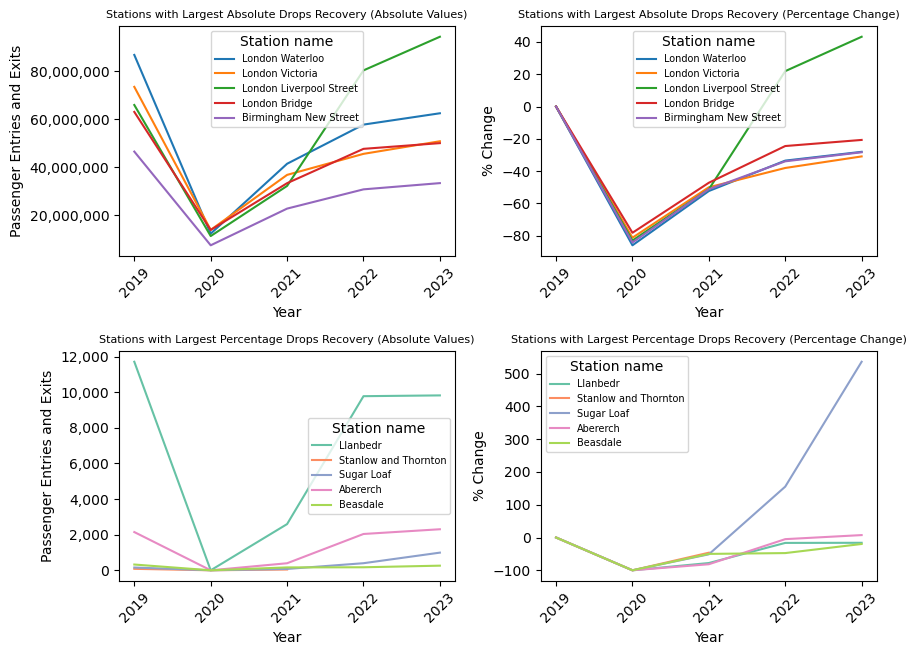

In [68]:
fig, ax = plt.subplots(2, 2, figsize=(9, 7))

# first plot: Most impacted stations (absolute values)
sns.lineplot(
    data=station_usage_sorted.loc[most_impacted_absolute],
    x='Year',
    y='Total_number_of_passenger_entries_and_exits',
    hue='Station name',
    palette = 'tab10',
    ax=ax[0, 0]
)
ax[0, 0].set_title("Stations with Largest Absolute Drops Recovery (Absolute Values)", fontsize=8)
ax[0, 0].set_ylabel('Passenger Entries and Exits')
ax[0, 0].yaxis.set_major_formatter(FuncFormatter(comma_formatter))
ax[0, 0].tick_params(axis='x', rotation=45)
ax[0, 0].legend(title='Station name', loc='best', prop={'size': 7}) 

# second plot: Most impacted stations (percentage change)
sns.lineplot(
    data=station_percent_change.loc[most_impacted_absolute],
    x='Year',
    y='% change',
    hue='Station name',
    palette = 'tab10',
    ax=ax[0, 1]
)
ax[0, 1].set_title("Stations with Largest Absolute Drops Recovery (Percentage Change)", fontsize=8)
ax[0, 1].set_ylabel('% Change')
ax[0, 1].tick_params(axis='x', rotation=45)
ax[0, 1].legend(title = 'Station name', loc = 'best', prop = {'size': 7})

# third plot: Most impacted by % change (absolute values)
sns.lineplot(
    data=station_usage_sorted.loc[most_impacted_percent],
    x='Year',
    y='Total_number_of_passenger_entries_and_exits',
    hue='Station name',
    palette="Set2",
    ax=ax[1, 0]
)
ax[1, 0].set_title("Stations with Largest Percentage Drops Recovery (Absolute Values)", fontsize=8)
ax[1, 0].set_ylabel('Passenger Entries and Exits')
ax[1, 0].yaxis.set_major_formatter(FuncFormatter(comma_formatter))
ax[1, 0].tick_params(axis='x', rotation=45)
ax[1, 0].legend(title = 'Station name', loc = 'best', prop = {'size': 7})

# fourth plot: Most impacted by % change (percentage change)
sns.lineplot(
    data=station_percent_change.loc[most_impacted_percent],
    x='Year',
    y='% change',
    hue='Station name',
    palette="Set2",  
    ax=ax[1, 1]  
)
ax[1, 1].set_title("Stations with Largest Percentage Drops Recovery (Percentage Change)", fontsize=8)
ax[1, 1].set_ylabel('% Change')
ax[1, 1].tick_params(axis='x', rotation=45)
ax[1, 1].legend(title = 'Station name', loc = 'best', prop = {'size': 7})

fig.tight_layout(rect=[0, 0, 1, 0.95])

plt.show()


Examining the most impacted stations varies wildly depending on if you define impact by percentage change or absolute change. The most heavily impacted stations by percentage change are all stations with small ridership (<12,000 entries and exits per year), and those with large drops are some of the most heavily ridden, which is logical as they have some of the most passenger movement to *lose* during the pandemic. We can compare this to the most impacted stations by *percentage* decrease, which are nearly all small stations which saw 100% drops in 2020. As far as we are aware, these zeroes in the data indicate true zeroes, not NaNs.

Thus, we see that some of the most heavily impacted stations by absolute ridership are in London, and only one of the stations has reached pre-COVID levels. In nearly the inverse, the most heavily impacted stations by percentage are all small stations, some of which were closed due to the pandemic, resulting in 100% ridership drops. Though the smaller stations have become closer to baseline level than the larger stations, only one has superseded COVID travel. 

These stations with large percentage drops are interesting for answering our other research questions. These large drops in train usage may have led to great drops in mobility toward grocery stores, retail areas, et cetera. This potential correlation is what questions 3 and 4 seek to answer. 

Finally, we will examine if there are clusters of stations which have recovered at similar rates to see if there are notable trends in recovery.

<a id="3_2_1"></a>
#### Question 2.1 : Are there clusters of stations which recovered similarly?

The last chunk of analysis we will do in this section is to see if there are clusters of stations which have recovered similarly in terms of ridership. To do this, we'll create a distance matrix based on percentage recovered in 2023. This compares the 2019 passenger entries and exits to 2023; therefore, if the percentage is below zero, the station has still not completely recovered. We then create a dissimilarity matrix to examine if there are clusters of stations which have recovered at similar rates relative to others.

In [69]:
# look at station usage % change in 2023 from 2020
# want to see how much stations have recovered from 2020 drop 

station_usage_2023 = station_percent_change.loc[station_percent_change['Year'] == '2023'].copy()
station_usage_2023['% recovery'] = (
    (station_usage_2023['Total_number_of_passenger_entries_and_exits'] - station_usage_2023['Total_number_of_passenger_entries_and_exits_base']) 
    / (station_usage_2023['Total_number_of_passenger_entries_and_exits_base'])
) * 100

station_usage_2023['% recovery'] = pd.to_numeric(station_usage_2023['% recovery'], errors = 'coerce')
station_usage_2023.reset_index(inplace=True)

In [70]:
# creating a recovery distance matrix
dissimilarity_matrix = squareform(pdist(station_usage_2023.loc[:,['% recovery']], metric='euclidean'))

Text(0.5, 1.0, 'Distance Matrix, Recovery by Station')

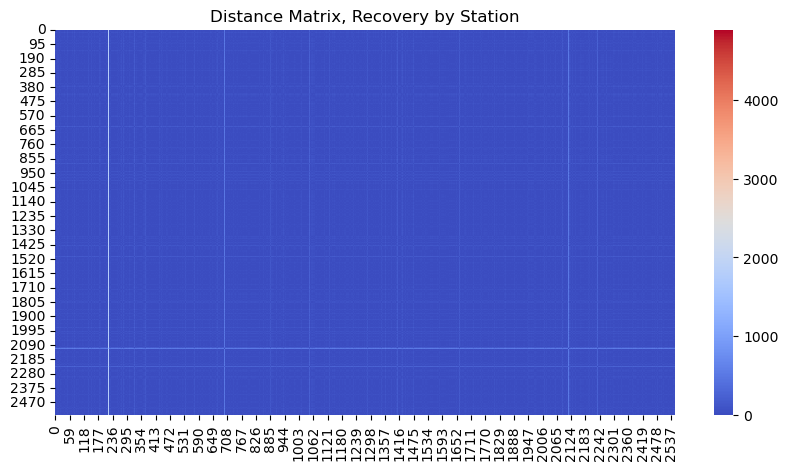

In [71]:
plt.figure(figsize=(10, 5))
sns.heatmap(dissimilarity_matrix, cmap='coolwarm',  cbar=True)
plt.title("Distance Matrix, Recovery by Station")

As we can see, recovery was very homogenous. There are no major clusters of simliarities or differences in terms of the recovery rate of train stations in the United Kingdom. This implies that despite minor differences in station percentage declines, they seem to have recovered to similar levels.

We then move into incorporating the Google Mobility data to better understand how mobility to economic centers was impacted, and how it was related to public transit decreases.

### Question 3: What regions saw the largest impact in other forms of mobility in terms of retail and recreation, grocery and pharmacy, and workplaces? <a class="anchor" id="3_3"></a> 


In [72]:
# Generate a sub-dataset containing necessary variables
impact_df = combined_df[["Region", "year", 
                         "retail_and_recreation_percent_change_from_baseline", 
                         "grocery_and_pharmacy_percent_change_from_baseline", 
                         "workplaces_percent_change_from_baseline"]].copy()  # prevent warnings

# Convert year and region to categorical for Altair
impact_df["year"] = impact_df["year"].astype(str)
impact_df["Region"] = impact_df["Region"].astype(str)

# Melt the dataframe for visualization
melted_df_all = impact_df.melt(id_vars=["Region", "year"], 
                               value_vars=["retail_and_recreation_percent_change_from_baseline",
                                           "grocery_and_pharmacy_percent_change_from_baseline",
                                           "workplaces_percent_change_from_baseline"],
                               var_name="Category", 
                               value_name="Percent Change")

# Rename categories 
category_mapping = {
    "retail_and_recreation_percent_change_from_baseline": "Retail & Recreation",
    "grocery_and_pharmacy_percent_change_from_baseline": "Grocery & Pharmacy",
    "workplaces_percent_change_from_baseline": "Workplaces"
}
melted_df_all["Category"] = melted_df_all["Category"].map(category_mapping)

# Create a heatmap for a specific mobility category
def create_heatmap(category_name):
    return alt.Chart(melted_df_all[melted_df_all["Category"] == category_name]).mark_rect().encode(
        x=alt.X("year:O", title="Year", axis=alt.Axis(labelAngle=-45)),
        y=alt.Y("Region:N", title="Region", sort="-x"),
        color=alt.Color("Percent Change:Q", scale=alt.Scale(scheme="redblue"), title="Change from Baseline"),
        tooltip=["Region", "year", "Percent Change"]
    ).properties(
        title=f"{category_name} - Mobility Change Heatmap",
        width=200,
        height=100
    )

# Create three heatmaps for each mobility category
heatmap_retail = create_heatmap("Retail & Recreation")
heatmap_grocery = create_heatmap("Grocery & Pharmacy")
heatmap_workplaces = create_heatmap("Workplaces")

heatmap_retail & heatmap_grocery & heatmap_workplaces

alt.VConcatChart(...)

From the graph, we can tell that COVID-19 did affect people's mobility. Urban regions like London and Scotland saw sharper reductions in mobility, likely due to stricter measures and higher compliance. Rural or less dense areas like the East Midlands and North East were less impacted. In addition, non-essential activities (retail and recreation) suffered the most severe reductions, while essential services (grocery and pharmacy) showed resilience. 

**Retail & Recreation**:
* All regions saw notable falls in mobility in 2020, with London and Scotland seeing the biggest drops. Stricter lockdowns and the closing of non-essential establishments like shopping centres and parks had a greater effect on urban areas. 
* A slow recovery was noted in 2021, with the majority of the locations displaying softer reds. This indicates the partial reopening and relaxation of restrictions. 
* In the majority of locations, mobility either reached or surpassed the baseline in 2022. This recovery was probably aided by the lifting of limitations and an increase in consumer confidence. A notable outlider is London, which had the smallest recovery in these areas as of 2022.

**Grocery & Pharmacy**:
* Because grocery and pharmacy services were necessary and continued to operate during lockdowns, 2020 saw fewer drastic cuts than retail and recreation. The biggest decreases occurred in London and Scotland, presumably as a result of urban populations' increased reliance on delivery services.
* In the majority of locations, mobility returned to almost baseline levels in 2021.
* Many areas, particularly the North East and East Midlands, demonstrated higher mobility in 2022 than in the baseline, most likely as a result of a combination of population recovery and behavioural changes.

**Workplaces**:
* Significant decreases in workplace mobility occurred in 2020, with darker reds in all regions—particularly in London and Scotland. This is a reflection of the pandemic's widespread use of remote work and office closures.
* Although there was some improvement in 2021, mobility was still below the baseline due to the continued use of hybrid working modes. 
* Many regions exhibit near-baseline or slightly below-baseline mobility in 2022, suggesting that for some industries, remote and hybrid work arrangements may have become the norm.

*London and Scotland*: These regions consistently show larger mobility reductions compared to others in all sectors during 2020 and 2021. Urbanization and stricter restrictions likely played a role.

*East Midlands and North East*: These regions show less severe reductions in all sectors, reflecting potentially less restrictive measures or differences in demographic and economic activity.

*Wales, South West, and Yorkshire*: These regions demonstrate moderate trends, with gradual recovery aligning with the national average.

*2020*: Marked by significant reductions in mobility, especially in non-essential sectors like retail and recreation and workplaces. Essential sectors like grocery and pharmacy were less impacted.

*2021*: Transition year with mobility nearing baseline in grocery and pharmacy but still below baseline for retail, recreation, and workplaces.

*2022*: Recovery year, with most sectors and regions returning to or exceeding baseline mobility, except for workplaces, which may reflect lasting changes in work patterns.




### Question 4: Is there a correlation between public transit usage and mobility of retail, grocery store usage, and workplace use (our proxies for economic indicators)?<a class="anchor" id="3_4"></a>

In [73]:
# Compute correlation matrix
corr_matrix = combined_df[["transit_stations_percent_change_from_baseline",
                   "retail_and_recreation_percent_change_from_baseline",
                   "grocery_and_pharmacy_percent_change_from_baseline",
                   "workplaces_percent_change_from_baseline"]].corr().reset_index()
# Rename variables for better readability
variable_mapping = {
    "transit_stations_percent_change_from_baseline": "Transit Stations",
    "retail_and_recreation_percent_change_from_baseline": "Retail & Recreation",
    "grocery_and_pharmacy_percent_change_from_baseline": "Grocery & Pharmacy",
    "workplaces_percent_change_from_baseline": "Workplaces"
}

# Convert the correlation matrix into a long format
corr_melted = corr_matrix.melt(id_vars="index", var_name="Variable", value_name="Correlation")
# Rename variables for better readability
corr_melted["index"] = corr_melted["index"].replace(variable_mapping)
corr_melted["Variable"] = corr_melted["Variable"].replace(variable_mapping)
# Heatmap visualization
heatmap = alt.Chart(corr_melted).mark_rect().encode(
    x=alt.X("index:N", title="Variable 1",axis=alt.Axis(labelAngle=-45)),
    y=alt.Y("Variable:N", title="Variable 2"),
    color=alt.Color("Correlation:Q", scale=alt.Scale(scheme="redblue"), title="Correlation"),
    tooltip=["index", "Variable", "Correlation"]
).properties(
    title="Correlation Matrix Heatmap",
    width=400,
    height=400
)


In [74]:
# Conducting Pearson correlation tests on cleaned data
transit_retail_corr, transit_retail_p = stats.pearsonr(
    combined_df["transit_stations_percent_change_from_baseline"], 
    combined_df["retail_and_recreation_percent_change_from_baseline"]
)

transit_grocery_corr, transit_grocery_p = stats.pearsonr(
    combined_df["transit_stations_percent_change_from_baseline"], 
    combined_df["grocery_and_pharmacy_percent_change_from_baseline"]
)

transit_work_corr, transit_work_p = stats.pearsonr(
    combined_df["transit_stations_percent_change_from_baseline"], 
    combined_df["workplaces_percent_change_from_baseline"]
)

# Displaying correlation results
correlation_results = pd.DataFrame({
    "Variable Pair": [
        "Transit vs Retail & Recreation", 
        "Transit vs Grocery & Pharmacy", 
        "Transit vs Workplaces"
    ],
    "Pearson Correlation": [
        transit_retail_corr, 
        transit_grocery_corr, 
        transit_work_corr
    ],
    "P-value": [
        transit_retail_p, 
        transit_grocery_p, 
        transit_work_p
    ]
})


display(correlation_results)
display(heatmap)


,Variable Pair,Pearson Correlation,P-value
0,Transit vs Retail & Recreation,0.699098,7.229337e-69
1,Transit vs Grocery & Pharmacy,0.567322,1.269385e-40
2,Transit vs Workplaces,0.651733,4.381325e-57


alt.Chart(...)

Transit mobility is most strongly tied to retail and recreation activities, followed by workplaces. This suggests that transit stations play a critical role in enabling non-essential and work-related mobility.

**Transit vs. Retail & Recreation**:
* Correlation (0.699): Moderate to strong positive correlation. Higher transit mobility is associated with higher retail and recreation mobility.
* P-value (7.2e-69): Extremely significant correlation.

**Transit vs. Grocery & Pharmacy**:
* Correlation (0.567): Moderate positive correlation. Grocery and pharmacy mobility is also linked to transit mobility, but the relationship is weaker than with retail and recreation.
* P-value (1.2e-40): Highly significant.

**Transit vs. Workplaces**:
* Correlation (0.652): Moderate to strong positive correlation. Transit mobility positively correlates with workplace visits, slightly less than with retail and recreation.
* P-value (4.4e-57): Highly significant.



After we get the correlation, we want to analyze and visualize the relationship between public transit changes and economic mobility indicators (retail, grocery, workplaces) across regions and years using regression model.

**OLS Regression Result**:
This graph will show the output of an Ordinary Least Squares (OLS) regression model that examines the relationship between:
* Dependent Variable (Mobility Change): Changes in economic mobility indicators (e.g., retail, grocery, workplaces).
* Independent Variable (transit_stations_percent_change_from_baseline): Changes in public transit usage.

**Scatter Plot with Regression Lines**:
This graph will visualize the relationship between public transit changes and economic indicator changes for three mobility types (Grocery & Pharmacy, Retail & Recreation, Workplaces).

In [75]:
# Convert the dataset into long format
melted_df = combined_df.melt(
    id_vars=["ISO_code", "Location_name", "Region", "year", "transit_stations_percent_change_from_baseline"],
    value_vars=[
        "retail_and_recreation_percent_change_from_baseline",
        "grocery_and_pharmacy_percent_change_from_baseline",
        "workplaces_percent_change_from_baseline"
    ],
    var_name="Variable",
    value_name="Mobility Change"
)

# Rename variables 
melted_df["Variable"] = melted_df["Variable"].replace({
    "retail_and_recreation_percent_change_from_baseline": "Retail & Recreation",
    "grocery_and_pharmacy_percent_change_from_baseline": "Grocery & Pharmacy",
    "workplaces_percent_change_from_baseline": "Workplaces"
})

# Compute correlation between transit and each economic indicator for each region-year
correlations = (
    melted_df.groupby(["Region", "year", "Variable"])
    .apply(lambda x: np.corrcoef(x["transit_stations_percent_change_from_baseline"], x["Mobility Change"])[0, 1])
    .reset_index()
)
correlations.columns = ["Region", "year", "Variable", "Correlation"]

# Merge correlation values into the melted dataset
melted_df = melted_df.merge(correlations, on=["Region", "year", "Variable"], how="left")



In [76]:
X = melted_df["transit_stations_percent_change_from_baseline"]
y = melted_df["Mobility Change"]

# Add a constant for the regression model (intercept)
X = sm.add_constant(X)

# Fit the regression model
model = sm.OLS(y, X, missing='drop').fit()

# Print regression summary
# print(model.summary())

In [77]:
# Create scatter plot of Transit Change vs Mobility Change
scatter_plot = alt.Chart(melted_df).mark_circle(size=60).encode(
    x=alt.X("transit_stations_percent_change_from_baseline:Q", title="Public Transit Change (%)"),
    y=alt.Y("Mobility Change:Q", title="Economic Indicator Change (%)"),
    color=alt.Color("Variable:N", title="Mobility Type"),
    tooltip=["Region", "year", "Variable", "Mobility Change", "transit_stations_percent_change_from_baseline"]
).properties(
    title="Regression Analysis: Public Transit vs Economic Indicators",
    width=600,
    height=400
)

# Add regression trendline
trendline = scatter_plot.transform_regression(
    "transit_stations_percent_change_from_baseline", "Mobility Change", 
    groupby=["Variable"], method="linear"
).mark_line().encode(
    color=alt.Color("Variable:N")
)

# Combine scatter plot and regression line
regression_plot = scatter_plot + trendline


In [78]:
print(model.summary())
regression_plot

                            OLS Regression Results                            
Dep. Variable:        Mobility Change   R-squared:                       0.189
Model:                            OLS   Adj. R-squared:                  0.189
Method:                 Least Squares   F-statistic:                     322.2
Date:                Thu, 13 Mar 2025   Prob (F-statistic):           6.45e-65
Time:                        12:27:22   Log-Likelihood:                -5733.0
No. Observations:                1383   AIC:                         1.147e+04
Df Residuals:                    1381   BIC:                         1.148e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                                                    coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------

alt.LayerChart(...)

**OLS Regression Results**:
* *R-squared (0.189)*: Indicates that 18.9% of the variance in Mobility Change is explained by transit_stations_percent_change_from_baseline. While low, this is expected for behavioral or social datasets, which typically have many influencing factors.
* *F-statistic and P-value*: The F-statistic is highly significant (p-value < 0.0001), indicating the overall model is statistically significant.
* *Intercept (const): -2.2604* This represents the baseline Mobility Change when transit_stations_percent_change_from_baseline is 0. Negative intercepts may indicate underlying economic declines during the pandemic.
* *Slope (transit_stations_percent_change_from_baseline): 0.5123* For every 1% increase in transit station mobility, there is an average 0.5123% increase in mobility to all three categories of locations. The coefficient is highly significant (p-value = 0.000), indicating a strong relationship.

**Scatter Plot with Regression Lines**:
* Separate regression lines for each mobility type show the direction and strength of the relationship.
* *Retail & Recreation (Orange)*: Steeper slope compared to Grocery & Pharmacy and Workplaces, suggesting a stronger dependence on transit changes.
* *Grocery & Pharmacy (Blue)*: Flatter slope, indicating a weaker relationship with transit changes.
* *Workplaces (Red)*: Moderate slope, reflecting a mix of reliance on transit and remote work.


The regression results and scatter plots confirm that increases in transit station usage positively correlate with our proxy economic indicators across all sectors. Retail & Recreation is the strongest dependence on transit, reflecting that these activities often require traveling to urban centers. Grocery & Pharmacy has a weaker relationship, as these are often localized services. Workplaces shows a moderate relationship, influenced by hybrid/remote work trends. However, the low R-squared suggests other factors (e.g., policy, demographics) significantly impact mobility, highlighting the complexity of human behavior.

## 4. Results and Conclusion <a id="4"></a>

In conclusion, the research explored the impact of COVID-19 on public transportation usage and its correlation with broader economic mobility indicators in the United Kingdom. 

**Impact on Public Transportation Usage:**

The COVID-19 pandemic resulted in a substantial decrease in public transportation utilization throughout the UK, with the majority of regions and stations witnessing decreases of 70-90% in 2020. Scotland and Wales suffered marginally greater declines, but the South West and London encountered the least relative reductions. Nonetheless, all reductions were substantial, with the smallest regional decline being as high as to 74%. Recovery patterns differed based on station size and location, with smaller stations exhibiting more significant percentage declines, frequently attributed to closures, whilst bigger stations demonstrated greater absolute drops.

**Station Recovery Patterns:**

As of 2023, the majority of stations exhibited partial recovery; nevertheless, no clear clusters of recovery patterns were apparent. This signifies a pretty uniform recovery trend throughout the UK. Stations with the most significant absolute declines were predominantly major centres such as London, although smaller regional stations had more substantial percentage losses owing to their reduced baseline attendance.

**Regional and Economic Mobility Changes:**

Mobility to retail and recreation, grocery and pharmacy, and workplaces was significantly impacted during the pandemic, with non-essential sectors like retail and recreation showing the largest decreases. Urban regions such as London and Scotland experienced sharper reductions in all categories, reflecting stricter restrictions and greater compliance. In contrast, rural regions like the East Midlands and North East were less affected. Mobility to essential services like grocery and pharmacy was more resilient, while workplaces showed gradual recovery as hybrid work patterns emerged.

**Correlation Between Transit Usage and Economic Indicators:**

Transit mobility showed a strong positive correlation with retail and recreation mobility, followed by workplaces and grocery and pharmacy.
Regression analysis indicated that a 1% increase in transit station usage corresponded to a 0.51% average increase in economic mobility indicators, with retail and recreation showing the strongest dependence on transit.

**Overall:**
This study highlights the profound impact of COVID-19 on public transportation usage and its cascading effects on economic mobility in the UK.
* Equity Implications: The disparate recovery of mobility underscores possible disparities, since urban centres and smaller stations encountered unique problems. Smaller stations, especially in rural regions, may have been disproportionately impacted by diminished availability to public transportation during lockdowns.
* Economic Recovery Patterns: The strong association between transit mobility and economic indicators highlights the essential function of public transport in facilitating economic activity, especially in the retail and recreation sectors. Areas with sluggish transportation recovery may have extended economic difficulties.
* Behavioral Shifts: The continued decline in workplace mobility indicates enduring transitions to remote and hybrid work, potentially reshaping public transportation utilization and planning in the post-pandemic period.
* Policy Implications: Policymakers need to include these findings into the formulation of transportation recovery strategies, prioritizing assistance for areas and stations most adversely affected by the epidemic to guarantee equitable economic revitalization.

### References <a class="anchor" id="5"></a>

Brough, A. R., & Martin, K. D. (2021). Consumer privacy during (and after) the COVID-19 pandemic. Journal of Public Policy & Marketing, 40(1), 108-110. https://doi.org/10.1177/074391562092999

Ellcom, G. U. (2017). ELLCOM/UK-train-station-locations: The name, location as longitude and latitude, and 3alpha (CRS) code for all the train stations in the United Kingdom as a JSON and CSV file. GitHub. https://github.com/ellcom/UK-Train-Station-Locations

Google. (2022). Google Community Mobility Reports, BigQuery Public Datasets Program. Google Cloud Console. https://console.cloud.google.com/marketplace/product/bigquery-public-datasets/covid19_google_mobility?pli=1&inv=1&invt=AbnRGQ&project=st445-transportation-project

Mack, E. A., Agrawal, S., & Wang, S. (2021). The impacts of the COVID-19 pandemic on transportation employment: A comparative analysis. Transportation Research Interdisciplinary Perspectives, 12, 100470. https://doi.org/10.1016/j.trip.2021.100470

Office for National Statistics. (2021). International Territorial Level (ITL) geography hierarchy boundaries, January 2021, UK, online. Open Geography Portal. https://geoportal.statistics.gov.uk/maps/ons::international-territorial-level-itl-geography-hierarchy-boundaries-january-2021-uk-online/explore?location=53.074145%2C-1.874400%2C4.32&path=

Office of Rail and Road. (2024, November 21). Estimates of station usage. Estimates of station usage | ORR Data Portal. https://dataportal.orr.gov.uk/statistics/usage/estimates-of-station-usage

Wikimedia Foundation. (2025, January 15). ISO 3166-2:GB. Wikipedia. https://en.wikipedia.org/wiki/ISO_3166-2:GB

Zhang, N., Jia, W., Wang, P., Dung, C. H., Zhao, P., Leung, K., ... & Li, Y. (2021). Changes in local travel behaviour before and during the COVID-19 pandemic in Hong Kong. Cities, 112, 103139. https://doi.org/10.1016/j.cities.2021.103139

